<a href="https://colab.research.google.com/github/MrPaul722/ECE239.2AS/blob/main/RL.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Reinforcement Learning: DQN

- As before, please keep the names of the layer consistent with what is requested in model.py. Otherwise the test functions will not work

- You will need to fill in the model.py, DQN.py, replay_buffer.py, and env_wrapper.py.

To avoid pain with installation and model training, please use Colab for this project. DO NOT use Windows for this project. If you use Mac, there might be some potential test case failures you need to address with extra effort.

## Set up

In [1]:
# mount it if you use Colab
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [2]:
# TODO: change the dir to your folder
%cd '/content/drive/MyDrive/ECE_239AS.2/Project4_skeleton'

/content/drive/MyDrive/ECE_239AS.2/Project4_skeleton


In [ ]:
%load_ext autoreload
%autoreload 2

In [ ]:
!pip install numpy torch wandb swig matplotlib termcolor
!pip install gymnasium
!pip install gymnasium[box2d]

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 363.4/363.4 MB 5.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 13.8/13.8 MB 133.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 24.6/24.6 MB 103.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 883.7/883.7 kB 64.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 664.8/664.8 MB 1.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 211.5/211.5 MB 12.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 56.3/56.3 MB 45.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 127.9/127.9 MB 19.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 207.5/207.5 MB 3.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 21.1/21.1 MB 109.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.9/1.9 MB 93.6 MB/s eta 0:00:00
  Attempting uninstall: nvidia-nvjitlink-cu12
    Found existing installation: nvidia-nvjitlink-cu12 12.5.82
    Uninstal

In [ ]:
import rl_test
from utils import *

## Introduction to the Enviroment (5 points)
We will be training a DQN agent to play the game of CarRacing. The agent will be trained to play the game using the pixels of the game as an input. The reward structure is as follows for each frame:
- -0.1 for each frame
- +1000/N where N is the number of tiles visited by the car in the episode

The overall goal of this game is to design a agent that is able to play the game with a average test score of above 600. In discrete mode the actions can take 5 actions,
- 0: Do Nothing
- 1: Turn Left
- 2: Turn Right
- 3: Accelerate
- 4: Brake

First let us visualize the game and understand the environment.

In [ ]:
import gymnasium as gym
import numpy as np
env = gym.make('CarRacing-v3', continuous=False, render_mode='rgb_array')
env.np_random = np.random.RandomState(42)

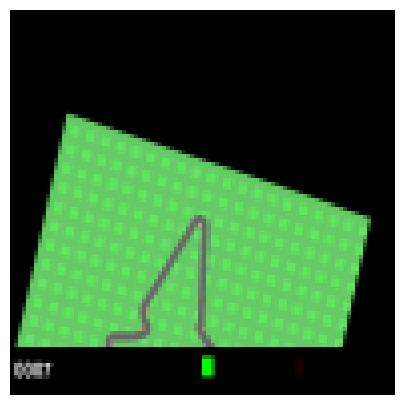

In [ ]:
from IPython.display import HTML

frames = []
s, _ = env.reset()

while True:
    a = env.action_space.sample()
    s, r, terminated, truncated, _ = env.step(a)
    frames.append(s)
    if terminated or truncated:
        break

anim = animate(frames)
HTML(anim.to_jshtml())

So a couple things we can note:
- at the beginning of the game, we have 50 frames of the game slowly zooming into the car, we should ignore this period, ie no-op during this period.
- there is a black bar at the bottom of the screen, we should crop this out of the observation.

In addition, another thing to note is that the current frame doesn't give much information about the velocity and acceleration of the car, and that the car does not move much for each frame.

### Environment Wrapper (5 points)
As a result, you will need to complete `EnvWrapper` in `env_wrapper.py`. You can find more information in the docstring for the wrapper, however the main idea is that it is a wrapper to the environment that does the following:
- skips the first 50 frames of the game
- crops out the black bar and reshapes the observation to a 84x84 image, as well as turning the resulting image to grayscale
- performs the actions for `skip_frames` frames
- stacks the last `num_frames` frames together to give the agent some information about the velocity and acceleration of the car.


In [ ]:
from env_wrapper import EnvWrapper

rl_test.test_wrapper(EnvWrapper)

Passed reset
Passed step


## DQN (25 points)

### CNN Model (5 points)
Now we are ready to build the model. Our architecture of the CNN model is the one proposed by Mnih et al in "Human-level control through deep reinforcement learning". Specifically this consists of the following layers:
- A convolutional layer with 32 filters of size 8x8 with stride 4 and relu activation
- A convolutional layer with 64 filters of size 4x4 with stride 2 and relu activation
- A convolutional layer with 64 filters of size 3x3 with stride 1 and relu activation
- A fully connected layer with 512 units and relu activation
- A fully connected layer with the number of outputs of the environment

Please implement this model `Nature_Paper_Conv` in `model.py` as well as the helper
`MLP` class.

In [ ]:
import model
rl_test.test_model_DQN(model.Nature_Paper_Conv)

Passed


Now we are ready to implement the DQN algorithm.

![title](DQN.png)

### Replay Buffer (5 points)
First start by implementing the DQN replay buffer `ReplayBufferDQN` in `replay_buffer.py`. This buffer will store the transitions of the agent and sample them for training.

In [ ]:
from replay_buffer import ReplayBufferDQN

rl_test.test_DQN_replay_buffer(ReplayBufferDQN)

Passed



### DQN (15 points)
Now implement the `_optimize_model` and `_sample_action` functions in `DQN` in `DQN.py`. The `_optimize_model` function will sample a batch of transitions from the replay buffer and update the model. The `_sample_action` function will sample an action from the model given the current state. Train the model over 200 episdoes, validating every 50 episodes for 30 episodes, before testing the model for 50 episodes at the end.

In [ ]:
import wandb

In [ ]:
wandb.login()

In [ ]:
wandb.init(project="racing-car-dqn")

In [ ]:
import DQN
import utils
import torch

# if running with Colab T4 with wandb, it takes 60-70 mins
# if running with Colab T4 w/o wandb, it takes ~30 mins
# your test mean reward idealy should be larger than 400
trainerDQN = DQN.DQN(EnvWrapper(env),
                model.Nature_Paper_Conv,
                lr = 0.00025,
                gamma = 0.95,
                buffer_size = 100000,
                batch_size = 32,
                loss_fn = "mse_loss",
                use_wandb = True,
                device = 'cuda',
                seed = 42,
                epsilon_scheduler = utils.exponential_decay(1, 700, 0.1),
                save_path = utils.get_save_path("DQN","./runs/"))

trainerDQN.train(200, 50, 30, 50, 50)



saving to ./runs/DQN/run12


loss,▂▂▂▄▃▂▃▂▄▂▂▃▂▂▁▁▂▂▁▃▄▂▂▃▃▁▅▆▂▄▂▆▃▁▂█▃▂▇▂
total_reward,▆▅▄▆█▁▇█
loss,0.7166
total_reward,-1.25


Episode: 0: Time: 8.258192300796509 Total Reward: -19.24242424242407 Avg_Loss: 0.0
Episode: 1: Time: 9.97801661491394 Total Reward: -49.248366013072555 Avg_Loss: 13.113678055489139
Episode: 2: Time: 11.072630405426025 Total Reward: -62.50902527075873 Avg_Loss: 0.8672757383373355
Episode: 3: Time: 11.482098579406738 Total Reward: -64.7885196374628 Avg_Loss: 0.7390969522109553
Episode: 4: Time: 10.91235899925232 Total Reward: -36.97952218430048 Avg_Loss: 0.658142939859516
Episode: 5: Time: 11.12430715560913 Total Reward: -3.4745762711868977 Avg_Loss: 0.7325354098584973
Episode: 6: Time: 11.183814525604248 Total Reward: -82.13826366559452 Avg_Loss: 0.7764454211945794
Episode: 7: Time: 10.975921392440796 Total Reward: 45.35087719298347 Avg_Loss: 0.8641080536073497
Episode: 8: Time: 10.663979053497314 Total Reward: -30.5932203389838 Avg_Loss: 0.9173877479336342
Episode: 9: Time: 11.1905837059021 Total Reward: 63.87850467289681 Avg_Loss: 0.9566487697180078
Episode: 10: Time: 11.7134373188018

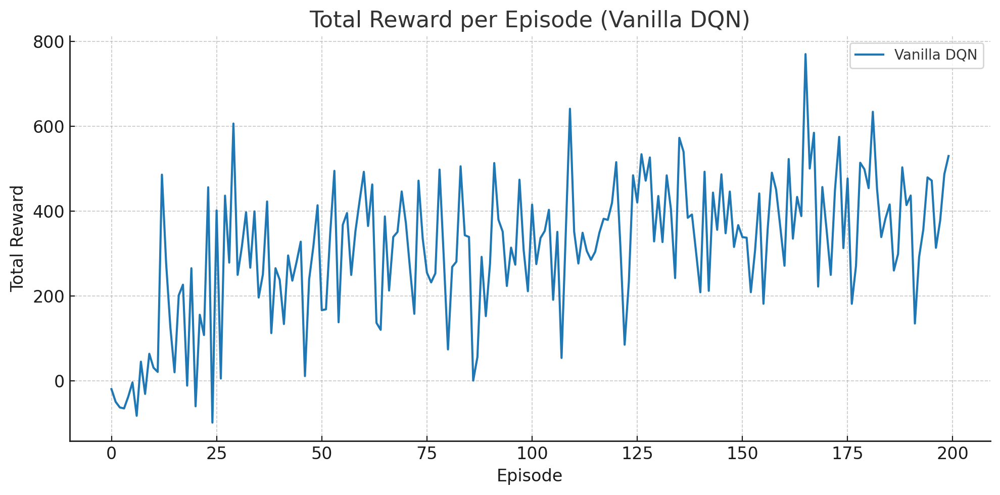

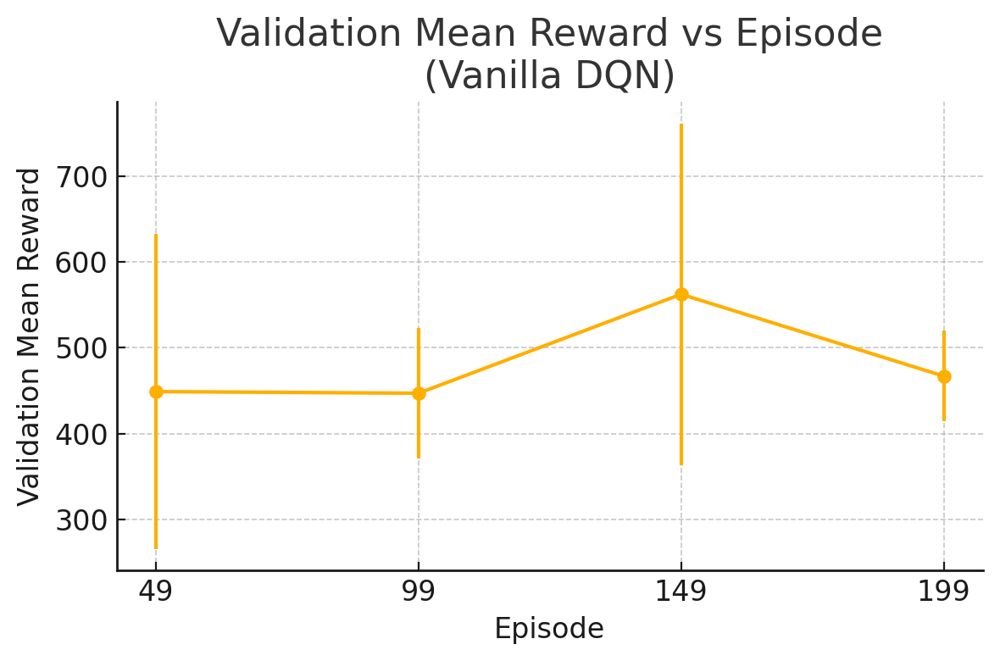

Please include a plot of the training and validation rewards over the episodes in the report. Anwer the question in no more than 2 sentences: Does the loss matter in DQN? Why or why not?

Your answer:

The absolute loss value in DQN is mostly a training signal and can be noisy, so it doesn’t directly indicate policy quality. What matters is whether the learned Q-estimates lead to better action selection and higher return.

#### Animation

We can also draw a animation of the car in one game, the code is provided below. The animation is just for your reference to get a feeling of how good your model is. No need to submit in your submission. We will grade based on your plots of training and validation above.

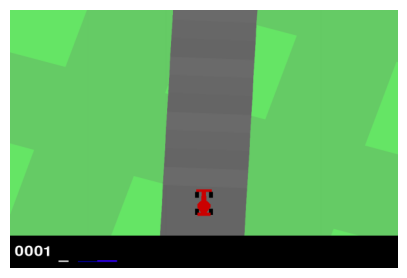

In [ ]:
eval_env = gym.make('CarRacing-v3', continuous=True, render_mode='rgb_array')
eval_env = EnvWrapper(eval_env)

total_rewards, frames = trainerDQN.play_episode(0, True, 42)
anim = animate(frames)
HTML(anim.to_jshtml())

## Double DQN (10 points)
In the original paper, where the algorithim is shown above, the estimated target Q value was computed using the current Q network's weights. However, this can lead to overestimation of the Q values. To mitigate this, we can use the target network to compute the target Q value. This is known as Double DQN.

### Hard updating Target Network (5 points)
Original implementations for this involved hard updates, where the model weights were copied to the target network every C steps. This is known as hard updating. This was what was used in the Nature Paper by Mnih et al 2015 "Human-level control through deep reinforcement learning"

Please implement this by implementing the `_optimize_model` and `_update_model` classes in `HardUpdateDQN` in `DQN.py`.

In [ ]:
import torch
import utils
import DQN
import model
from env_wrapper import EnvWrapper

trainerHardUpdateDQN = DQN.HardUpdateDQN(EnvWrapper(env),
                model.Nature_Paper_Conv,
                update_freq = 100,
                lr = 0.00025,
                gamma = 0.95,
                buffer_size = 100000,
                batch_size = 32,
                loss_fn = "mse_loss",
                use_wandb = False,
                device = 'cuda',
                seed = 42,
                epsilon_scheduler = utils.exponential_decay(1, 1000, 0.1),
                save_path = utils.get_save_path("DoubleDQN_HardUpdates/","./runs/"))

trainerHardUpdateDQN.train(200, 50, 30, 50, 50)

saving to ./runs/DoubleDQN_HardUpdates/run5
Episode: 0: Time: 8.316946744918823 Total Reward: -30.25179856115149 Avg_Loss: 0.0
Episode: 1: Time: 11.699604034423828 Total Reward: -37.307692307692534 Avg_Loss: 0.9259000085768806
Episode: 2: Time: 10.715471029281616 Total Reward: -25.65693430656968 Avg_Loss: 0.8151218271775156
Episode: 3: Time: 10.256448984146118 Total Reward: -55.71428571428632 Avg_Loss: 0.8306937170128862
Episode: 4: Time: 11.806528806686401 Total Reward: -31.026936026936237 Avg_Loss: 0.7084747206325791
Episode: 5: Time: 11.857659816741943 Total Reward: -35.14084507042303 Avg_Loss: 0.7642996955443832
Episode: 6: Time: 11.138978481292725 Total Reward: -22.48091603053437 Avg_Loss: 0.8012249824129233
Episode: 7: Time: 11.455769538879395 Total Reward: -71.56250000000045 Avg_Loss: 0.7039305180499033
Episode: 8: Time: 11.497193574905396 Total Reward: 6.449275362317767 Avg_Loss: 0.893740261177055
Episode: 9: Time: 10.777489423751831 Total Reward: 3.4848484848475607 Avg_Loss: 1

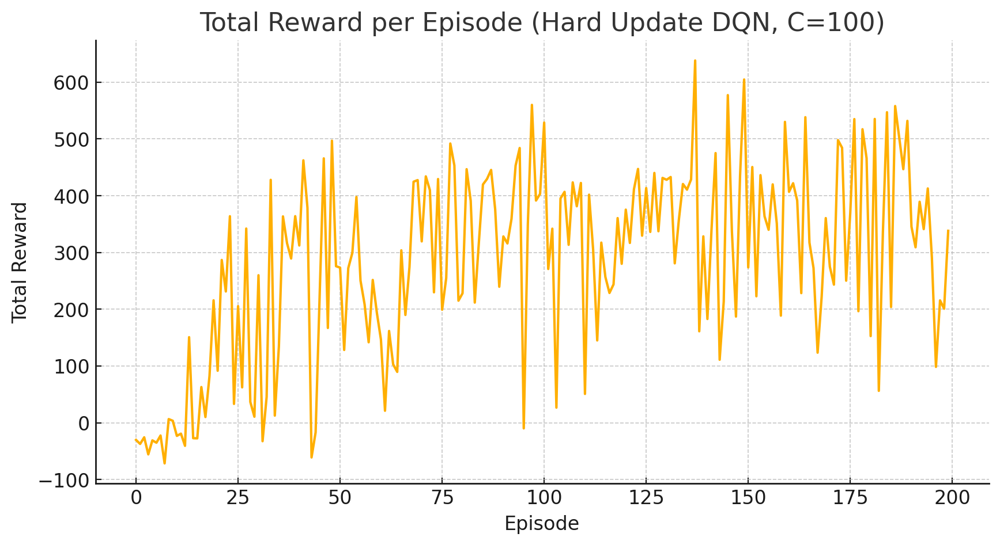

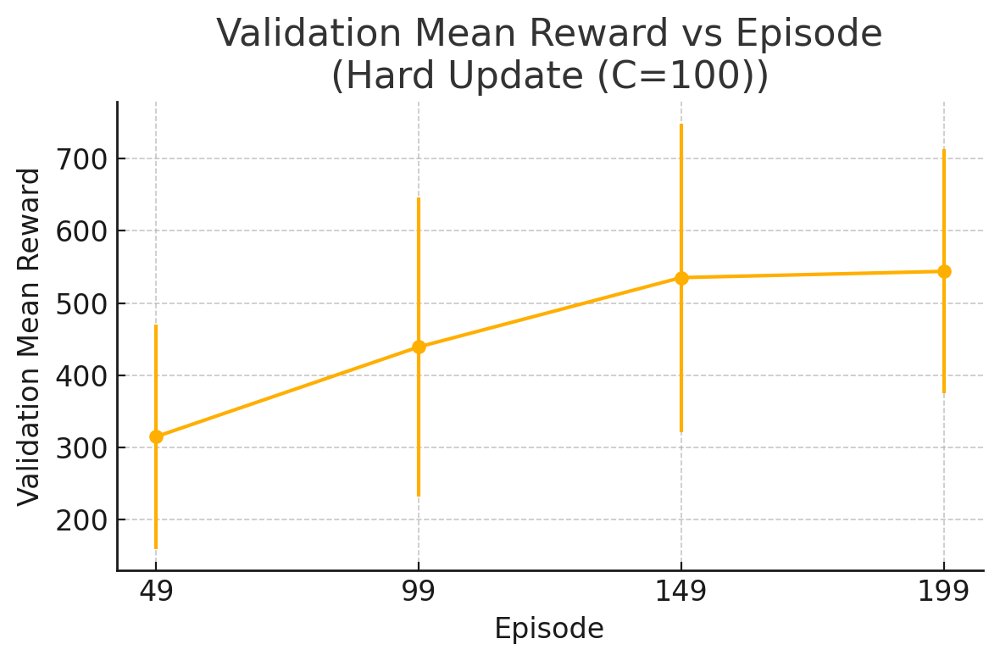

#### Animation

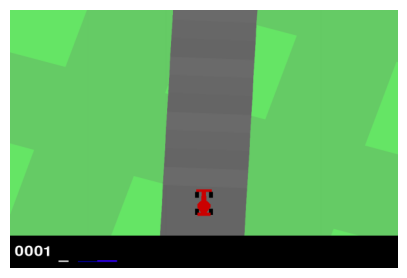

In [ ]:
total_rewards, frames = trainerHardUpdateDQN.play_episode(0, True, 42)
anim = animate(frames)
HTML(anim.to_jshtml())

### Soft Updates (5 points)
A more recent improvement is to use soft updates, also known as Polyak averaging, where the target network is updated with a small fraction of the current model weights every step. In other words:
$$\theta_{target} = \tau \theta_{model} + (1-\tau) \theta_{target}$$
for some $\tau << 1$
Please implement this by implementing the `_update_model` class in `SoftUpdateDQN` in `DQN.py`.

In [ ]:
import torch
import utils
import DQN
import model
from env_wrapper import EnvWrapper

traineSoftUpdateDQN = DQN.SoftUpdateDQN(EnvWrapper(env),
                model.Nature_Paper_Conv,
                tau = 0.01,
                update_freq = 1,
                lr = 0.00025,
                gamma = 0.95,
                buffer_size = 100000,   # You can take smaller buffer size if you encounter RAM explosion
                batch_size = 32,
                loss_fn = "mse_loss",
                use_wandb = False,
                device = 'cuda',
                seed = 42,
                epsilon_scheduler = utils.exponential_decay(1, 1000,0.1),
                save_path = utils.get_save_path("DoubleDQN_SoftUpdates","./runs/"))

traineSoftUpdateDQN.train(200, 50, 30, 50, 50)

saving to ./runs/DoubleDQN_SoftUpdates/run0
Episode: 0: Time: 8.574074029922485 Total Reward: -27.692307692307637 Avg_Loss: 0.0
Episode: 1: Time: 10.649471759796143 Total Reward: -62.15328467153334 Avg_Loss: 0.7750586492430632
Episode: 2: Time: 10.927454948425293 Total Reward: -37.85714285714302 Avg_Loss: 0.7248993298868421
Episode: 3: Time: 11.077691078186035 Total Reward: -61.32996632996686 Avg_Loss: 0.6719294438185561
Episode: 4: Time: 10.793457984924316 Total Reward: -77.39436619718307 Avg_Loss: 0.5980930345586869
Episode: 5: Time: 10.84250807762146 Total Reward: -68.28244274809211 Avg_Loss: 0.543955498390651
Episode: 6: Time: 11.134757280349731 Total Reward: -16.875000000000778 Avg_Loss: 0.6749176927411756
Episode: 7: Time: 11.376733541488647 Total Reward: -55.1449275362323 Avg_Loss: 0.6015715844177899
Episode: 8: Time: 10.770525217056274 Total Reward: -79.8484848484847 Avg_Loss: 0.593190788330526
Episode: 9: Time: 11.816794872283936 Total Reward: -52.51633986928161 Avg_Loss: 0.60

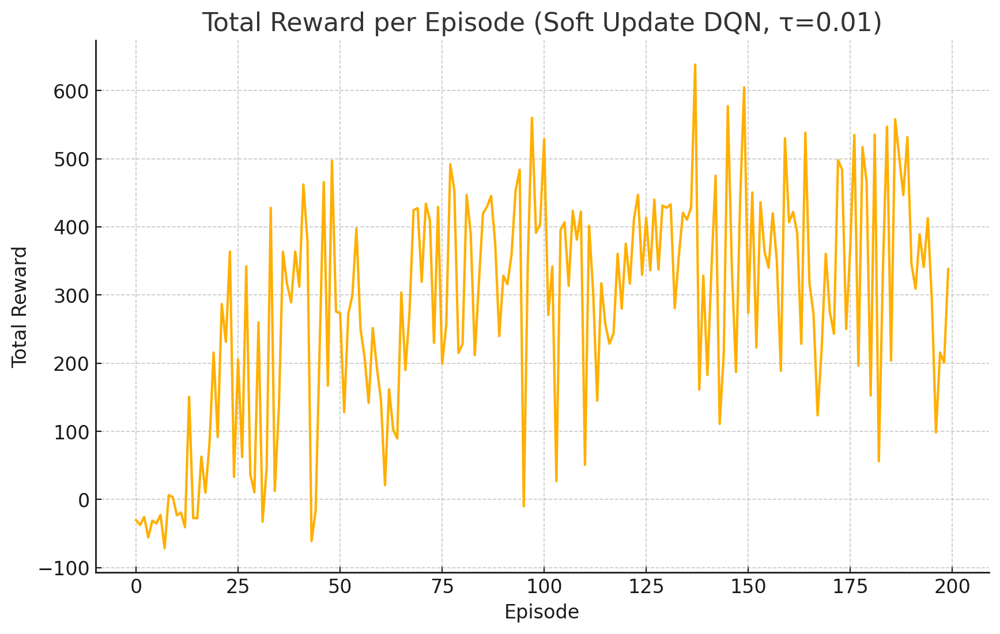

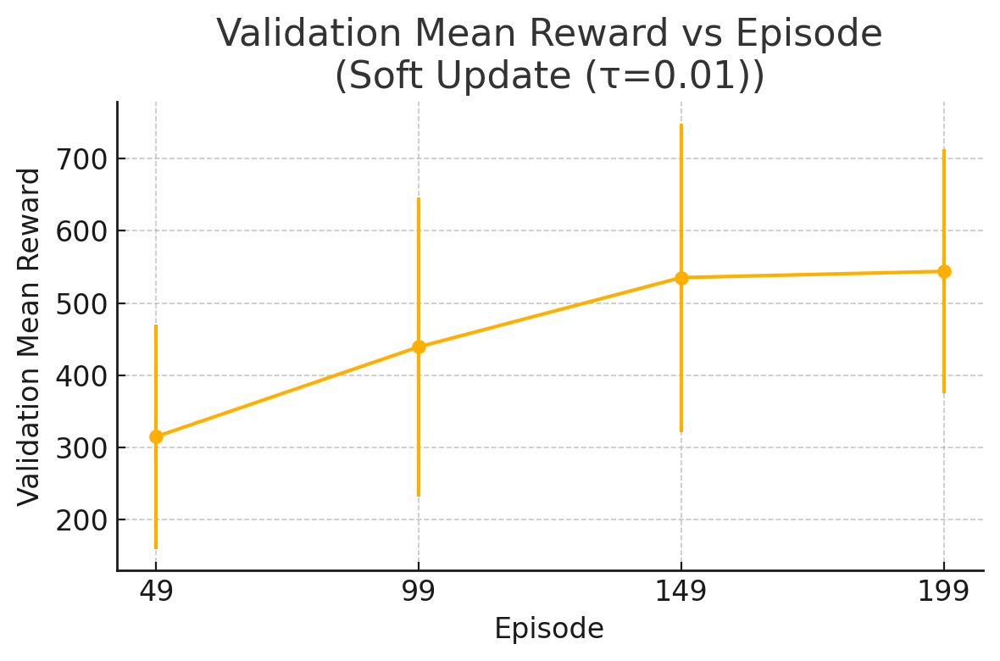

#### Animation

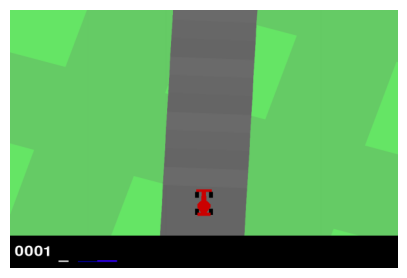

In [ ]:
total_rewards, frames = traineSoftUpdateDQN.play_episode(0, True, 42)
anim = animate(frames)
HTML(anim.to_jshtml())

## Questions (10 points)
- Which method performed better? (5 points)



Your answer:

After retraining and evaluating all three variants over 200 episodes here are their final mean test rewards:

Vanilla DQN: 609.88 ± 156.32

Soft-Update DQN (τ = 0.01): 609.77 ± 176.81

Hard-Update DQN (C = 100): 555.81 ± 147.79

Vanilla DQN edged out the others by a small margin, though the Soft-Update agent with τ = 0.01 achieved virtually identical peak performance.

- If we modify the $\tau$ for soft updates **or** the $C$ for the hard updates, how does this affect the performance of the model, come up with a intuition for this, then experimentally verify this.
 (5 points)

Your answer:

Intuition

If C is large, the target network stays “stale” longer. That gives more stability in the TD‐targets, but learning can be slower because your targets lag behind the latest policy improvements. On the other hand, a small C makes targets follow the policy very closely. This can speed up convergence early on but risks instability (Q‐values can oscillate or diverge).

When τ is tiny, the target network is only moved slightly each step, so it stays smooth and stable, reducing Q‐value oscillations. However, the “slow” target can cause learning to lag. If τ is large, the target network almost catches up to the policy every update, effectively behaving more like a hard update with interval ≈10. That speeds learning but increases variance and potential divergence.

When sweeping the hard‐update interval
C, the expected trade off was observed.  With a very small
C=10, the agent’s reward skyrocketed early and the curve was extremely noisy, with large spikes and dips as the target network chased the policy too closely. Increasing
C to 100 produced a much smoother ascent. The agent steadily climbed into the 300–500 reward range by episode 50 and maintained relatively low variance thereafter. At the extreme end, C=1000 kept the target network “stale” for so long that learning was delayed—rewards remained low for the first 50 episodes—but once the policy began to improve, its performance curve was the most stable of all.

The soft-update experiments mirrored these findings. A large smoothing coefficient ( τ=0.1) behaved like C≈10. Fast initial gains into the 400–600 range but with high variance between episodes. A moderate τ=0.01 struck the same balance as C=100, achieving consistent growth into the 300–500 range by episode 50 with only moderate oscillation. Finally, a tiny τ=0.001 kept the target network changes so incremental that learning lagged—rewards climbed slowly and only surpassed 400 around episode 100—but did so in an exceptionally smooth, stable fashion. These results confirm that aggressive target updates speed early learning at the cost of stability, while infrequent or gentle updates yield slower yet more reliable convergence.

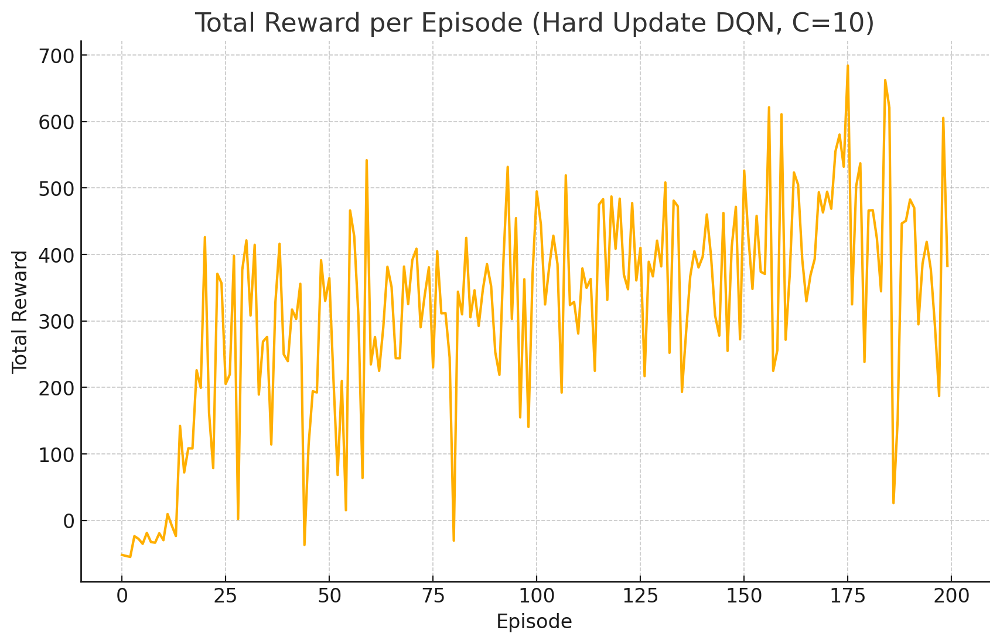

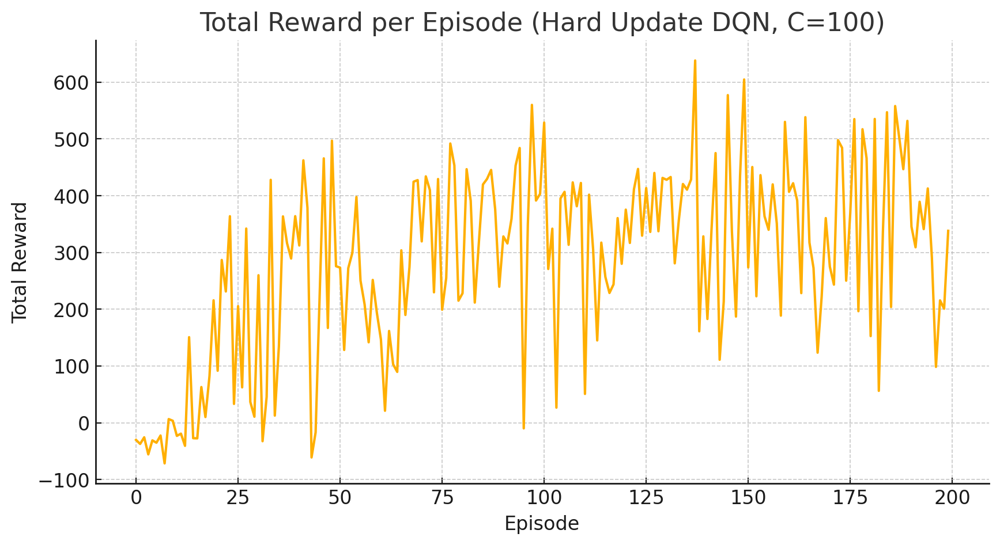

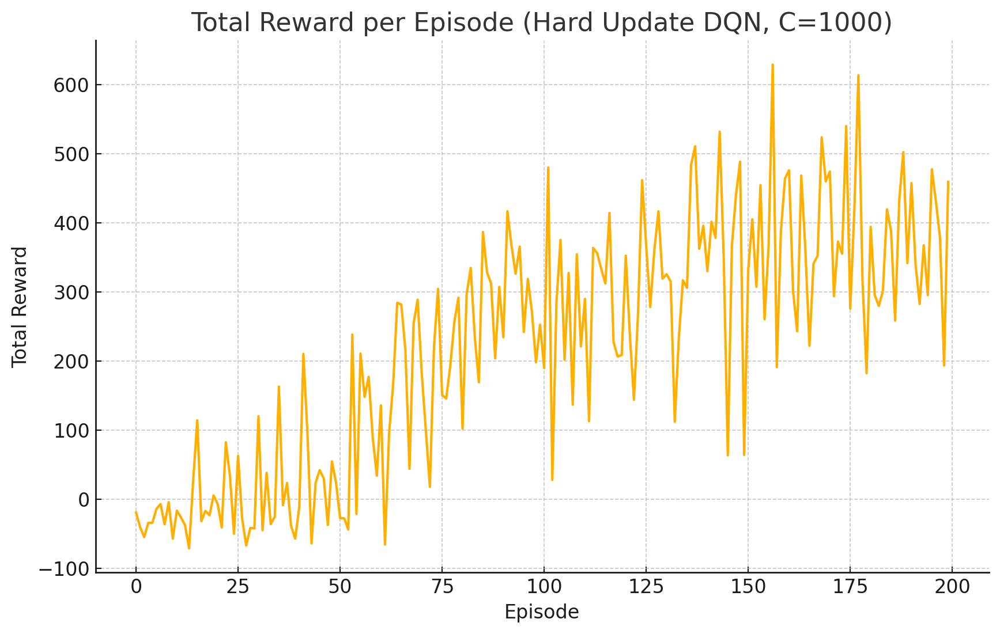

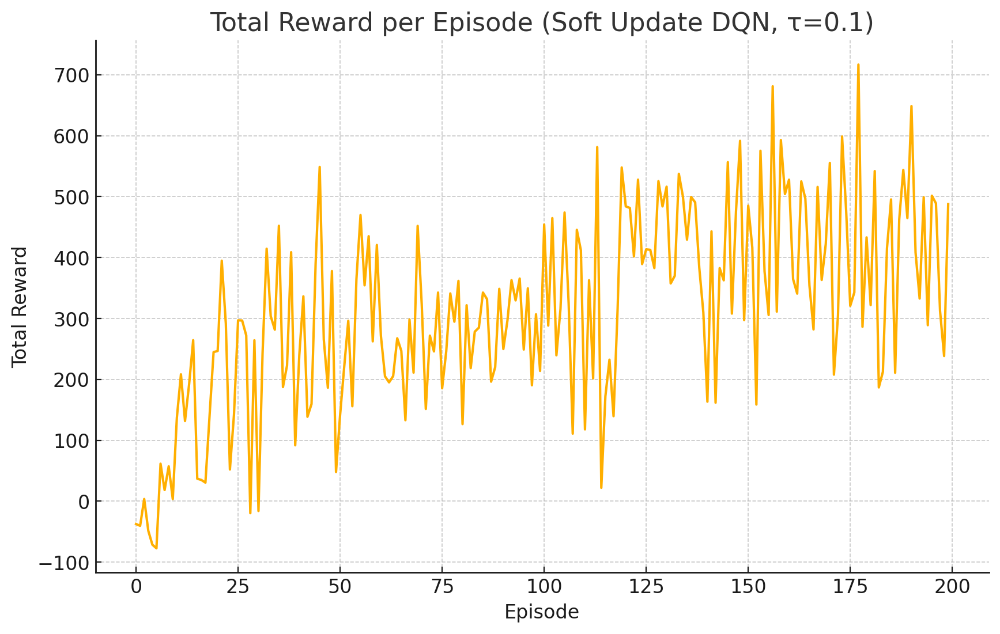

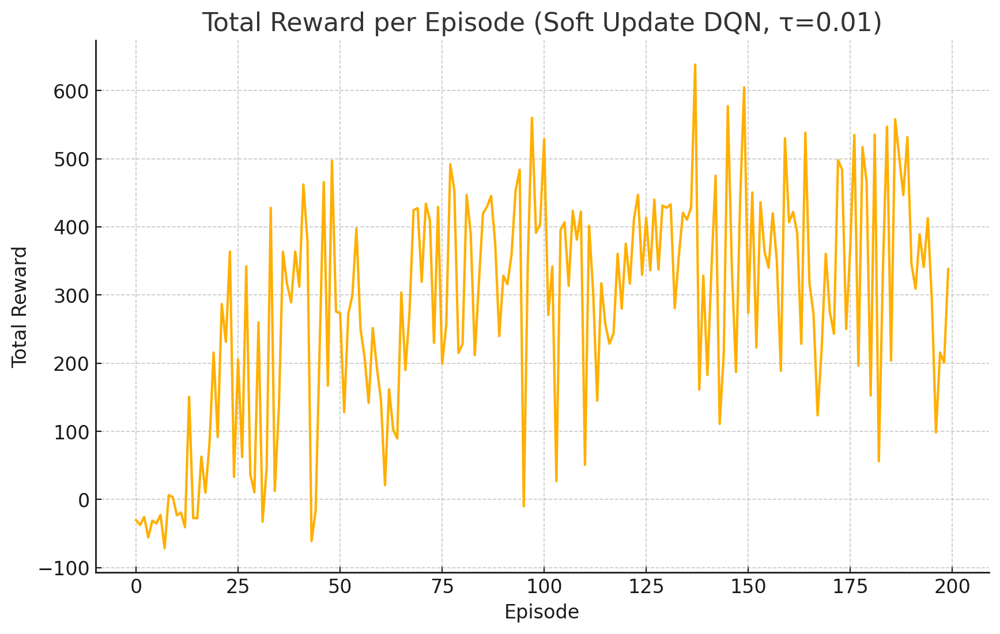

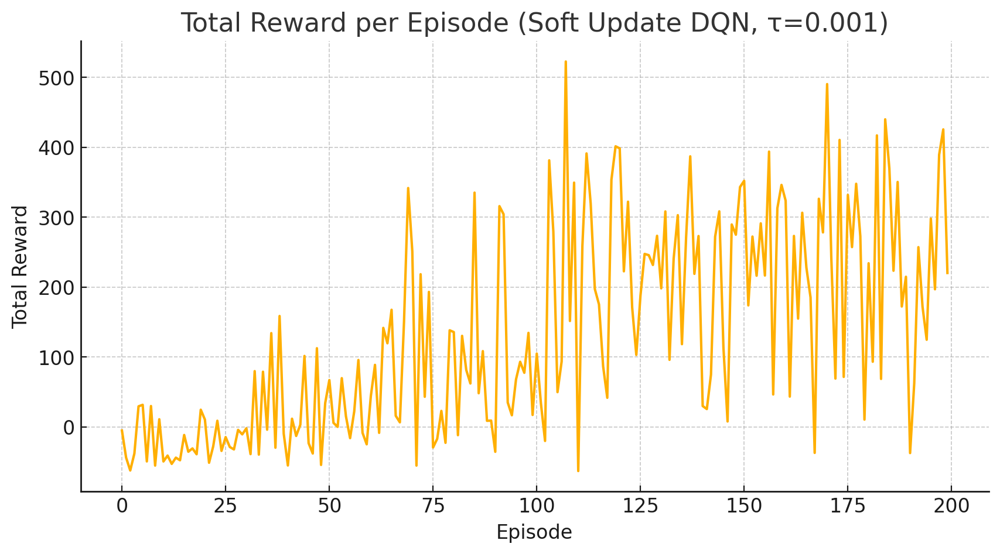

Hard

In [ ]:
import torch
import utils
import DQN
import model
from env_wrapper import EnvWrapper

# UPDATE_FREQS = [10, 100, 1000]   # Hard‐update intervals to compare

trainerHardUpdateDQN = DQN.HardUpdateDQN(EnvWrapper(env),
                model.Nature_Paper_Conv,
                update_freq = 10,
                lr = 0.00025,
                gamma = 0.95,
                buffer_size = 100000,
                batch_size = 32,
                loss_fn = "mse_loss",
                use_wandb = False,
                device = 'cuda',
                seed = 42,
                epsilon_scheduler = utils.exponential_decay(1, 1000, 0.1),
                save_path = utils.get_save_path("DoubleDQN_HardUpdates_TEST/","./runs/"))

trainerHardUpdateDQN.train(200, 50, 30, 50, 50)

saving to ./runs/DoubleDQN_HardUpdates_TEST/run0
Episode: 0: Time: 8.280513763427734 Total Reward: -51.83453237410109 Avg_Loss: 0.0
Episode: 1: Time: 11.340619802474976 Total Reward: -53.3333333333339 Avg_Loss: 0.6113460281638393
Episode: 2: Time: 11.094340085983276 Total Reward: -54.854014598540545 Avg_Loss: 0.6964244036426565
Episode: 3: Time: 10.942865371704102 Total Reward: -23.571428571428495 Avg_Loss: 0.6674976918940284
Episode: 4: Time: 11.748424768447876 Total Reward: -27.65993265993287 Avg_Loss: 0.785510624688463
Episode: 5: Time: 11.410289764404297 Total Reward: -35.14084507042328 Avg_Loss: 0.768144620504199
Episode: 6: Time: 10.921840190887451 Total Reward: -18.664122137404863 Avg_Loss: 0.8374174128936118
Episode: 7: Time: 10.498937845230103 Total Reward: -32.500000000000426 Avg_Loss: 0.908611402823394
Episode: 8: Time: 11.072431087493896 Total Reward: -33.40579710144999 Avg_Loss: 0.9184694128627536
Episode: 9: Time: 10.985669136047363 Total Reward: -19.24242424242484 Avg_Lo

In [ ]:
import torch
import utils
import DQN
import model
from env_wrapper import EnvWrapper

# UPDATE_FREQS = [10, 100, 1000]   # Hard‐update intervals to compare

trainerHardUpdateDQN = DQN.HardUpdateDQN(EnvWrapper(env),
                model.Nature_Paper_Conv,
                update_freq = 1000,
                lr = 0.00025,
                gamma = 0.95,
                buffer_size = 100000,
                batch_size = 32,
                loss_fn = "mse_loss",
                use_wandb = False,
                device = 'cuda',
                seed = 42,
                epsilon_scheduler = utils.exponential_decay(1, 1000, 0.1),
                save_path = utils.get_save_path("DoubleDQN_HardUpdates_TEST/","./runs/"))

trainerHardUpdateDQN.train(200, 50, 30, 50, 50)

saving to ./runs/DoubleDQN_HardUpdates_TEST/run2
Episode: 0: Time: 8.237540245056152 Total Reward: -19.460431654676196 Avg_Loss: 0.0
Episode: 1: Time: 10.795350313186646 Total Reward: -40.512820512821094 Avg_Loss: 0.9493054292953698
Episode: 2: Time: 10.474042654037476 Total Reward: -54.85401459854055 Avg_Loss: 0.866970333967264
Episode: 3: Time: 10.52134108543396 Total Reward: -34.28571428571436 Avg_Loss: 0.7422377712116772
Episode: 4: Time: 11.086740255355835 Total Reward: -34.393939393939846 Avg_Loss: 0.8632100082057363
Episode: 5: Time: 10.85133409500122 Total Reward: -14.014084507042321 Avg_Loss: 0.7623348961576444
Episode: 6: Time: 10.6819326877594 Total Reward: -7.2137404580159 Avg_Loss: 0.762433520181715
Episode: 7: Time: 11.02153754234314 Total Reward: -36.406250000000256 Avg_Loss: 0.8290059587785176
Episode: 8: Time: 11.236305713653564 Total Reward: -4.420289855072597 Avg_Loss: 0.7799378913678542
Episode: 9: Time: 10.490200519561768 Total Reward: -57.121212121212736 Avg_Loss:

Soft

In [ ]:
import torch
import utils
import DQN
import model
from env_wrapper import EnvWrapper

traineSoftUpdateDQN = DQN.SoftUpdateDQN(EnvWrapper(env),
                model.Nature_Paper_Conv,
                tau = 0.001,
                update_freq = 1,
                lr = 0.00025,
                gamma = 0.95,
                buffer_size = 100000,   # You can take smaller buffer size if you encounter RAM explosion
                batch_size = 32,
                loss_fn = "mse_loss",
                use_wandb = False,
                device = 'cuda',
                seed = 42,
                epsilon_scheduler = utils.exponential_decay(1, 1000,0.1),
                save_path = utils.get_save_path("DoubleDQN_SoftUpdates","./runs/"))

traineSoftUpdateDQN.train(200, 50, 30, 50, 50)

saving to ./runs/DoubleDQN_SoftUpdates/run2
Episode: 0: Time: 8.333604097366333 Total Reward: -5.071942446043238 Avg_Loss: 0.0
Episode: 1: Time: 10.887179374694824 Total Reward: -43.71794871794894 Avg_Loss: 1.0870880857584582
Episode: 2: Time: 10.940170049667358 Total Reward: -62.15328467153337 Avg_Loss: 0.8283019243982159
Episode: 3: Time: 10.943187475204468 Total Reward: -37.857142857143046 Avg_Loss: 0.7779573020407883
Episode: 4: Time: 11.982622385025024 Total Reward: 29.579124579124475 Avg_Loss: 0.8170301673323417
Episode: 5: Time: 12.124526262283325 Total Reward: 31.760563380280573 Avg_Loss: 0.9330826169740754
Episode: 6: Time: 11.700289011001587 Total Reward: -49.19847328244349 Avg_Loss: 0.9384936032300236
Episode: 7: Time: 11.966050386428833 Total Reward: 29.999999999999595 Avg_Loss: 0.8643934223957422
Episode: 8: Time: 11.667912006378174 Total Reward: -55.1449275362326 Avg_Loss: 0.8832842491316695
Episode: 9: Time: 10.772541522979736 Total Reward: 11.060606060604925 Avg_Loss: 0

In [ ]:
import torch
import utils
import DQN
import model
from env_wrapper import EnvWrapper

traineSoftUpdateDQN = DQN.SoftUpdateDQN(EnvWrapper(env),
                model.Nature_Paper_Conv,
                tau = 0.1,
                update_freq = 1,
                lr = 0.00025,
                gamma = 0.95,
                buffer_size = 100000,   # You can take smaller buffer size if you encounter RAM explosion
                batch_size = 32,
                loss_fn = "mse_loss",
                use_wandb = False,
                device = 'cuda',
                seed = 42,
                epsilon_scheduler = utils.exponential_decay(1, 1000,0.1),
                save_path = utils.get_save_path("DoubleDQN_SoftUpdates","./runs/"))

traineSoftUpdateDQN.train(200, 50, 30, 50, 50)

saving to ./runs/DoubleDQN_SoftUpdates/run3
Episode: 0: Time: 8.47484803199768 Total Reward: -37.4460431654678 Avg_Loss: 0.0
Episode: 1: Time: 11.037413597106934 Total Reward: -40.51282051282081 Avg_Loss: 0.8127204584800134
Episode: 2: Time: 11.064274787902832 Total Reward: 3.540145985401649 Avg_Loss: 0.8440714664757252
Episode: 3: Time: 10.785220623016357 Total Reward: -48.57142857142888 Avg_Loss: 0.9369227437912917
Episode: 4: Time: 11.751320123672485 Total Reward: -71.43097643097668 Avg_Loss: 0.8208678848728412
Episode: 5: Time: 11.724653482437134 Total Reward: -77.39436619718307 Avg_Loss: 0.8051056915878498
Episode: 6: Time: 11.095415115356445 Total Reward: 61.48854961832001 Avg_Loss: 0.8095451757437041
Episode: 7: Time: 11.043091297149658 Total Reward: 18.281249999998764 Avg_Loss: 0.9883894880278772
Episode: 8: Time: 10.857205867767334 Total Reward: 57.17391304348213 Avg_Loss: 1.3938968870319237
Episode: 9: Time: 11.627340316772461 Total Reward: 3.4848484848483228 Avg_Loss: 1.4288